In [58]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.offline as pyo
import plotly.graph_objects as go
pyo.init_notebook_mode()
import datetime
from sympy import Point, Line
from sklearn.metrics import r2_score, mean_squared_error
import sys
sys.path.insert(1, '../Scripts')
from funciones import SampleIDD, simbologia, grafico_posicion_section,graficar_sections, graficar_versus_core,graficar_versus_core_rock, graficar2, grafico_edades, grafico_posicion, simbologia_core

In [2]:
#-------------------- Load data
Data = pd.read_excel("../Data/TephraDataBase_normalizado.xlsx")
Data = Data.replace('-',np.nan)
Data = Data.replace('not determined',np.nan)
Data = Data.replace('Not analyzed',np.nan)
Data = Data.replace('n.a.',np.nan)
Data = Data.replace('n.d.',np.nan)
Data = Data.replace('Over range',np.nan)
Data = Data.replace('bdl',np.nan)
Data = Data.replace('<1',np.nan)
Data = Data.replace('<4',np.nan)
Data = Data.replace('<6',np.nan)
Data = Data.replace('<5',np.nan)
Data = Data.replace('<10',np.nan)
Data = Data.replace('<0.01',np.nan)
Data = Data.replace('<0.1',np.nan)
Data.Flag = Data.Flag.astype(str)
Data = Data[(Data.Flag.str.contains('Outlier') == False)]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


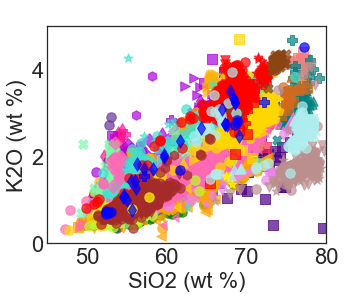

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


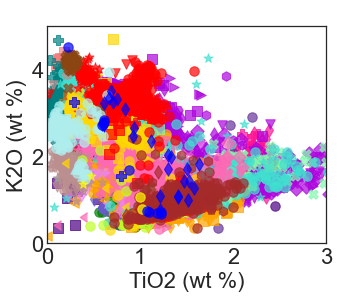

In [6]:
#Plot all data except samples for which the volcano originating the volcanic products is still unknown
graficar_versus_core('SiO2','K2O',Data[Data.Volcano!='Unknown'] ,Xmin=45,Xmax=80,Ymin=0,Ymax=5)

### 1.- Calculate and visualize 'effusive' and 'bulk pyroclastic' products linear regressions (SiO2 versus K2O)

C:\Users\consue\AppData\Local\Temp\ipykernel_628\2497877523.py:25: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



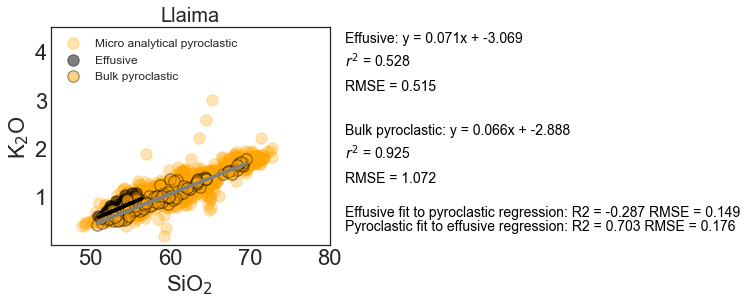

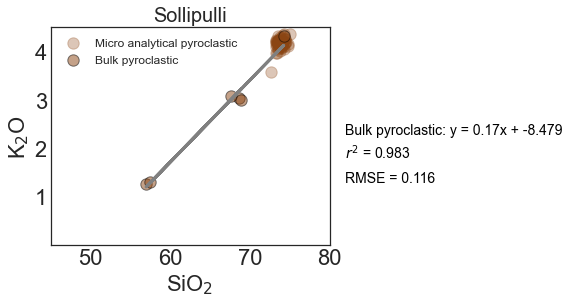

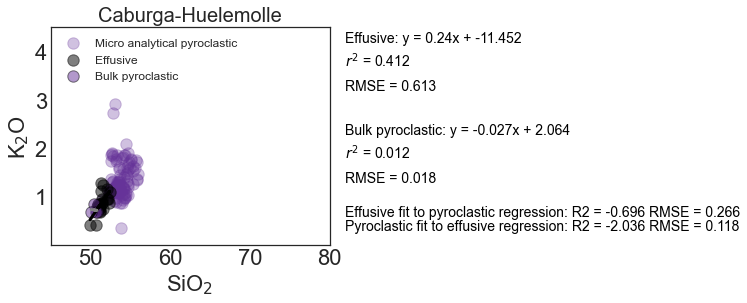

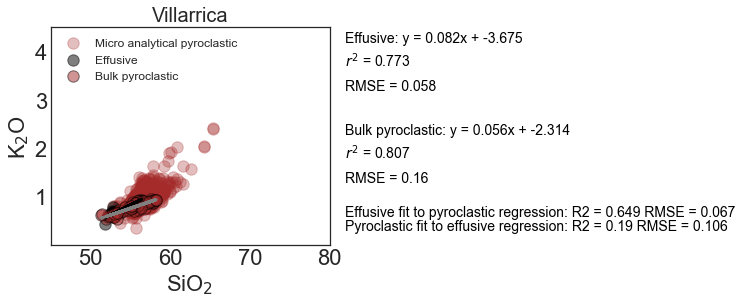

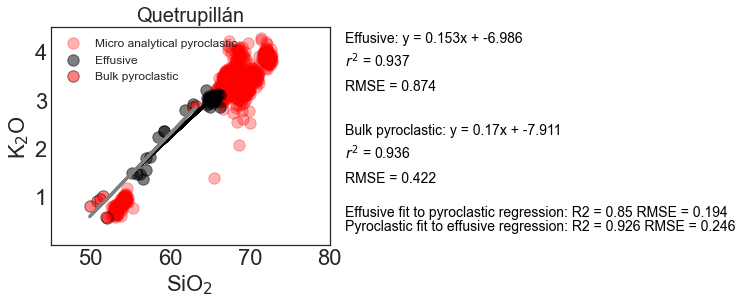

...

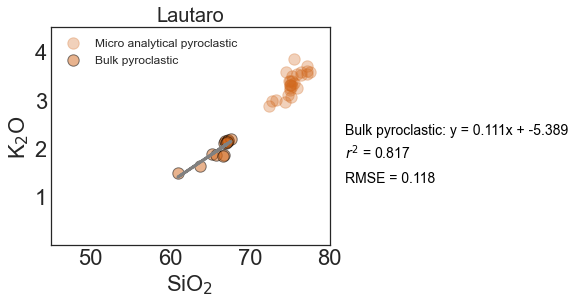

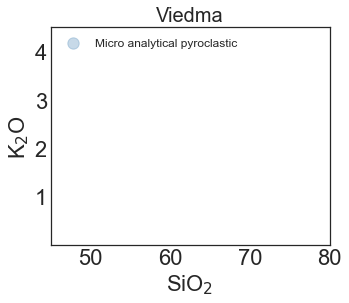

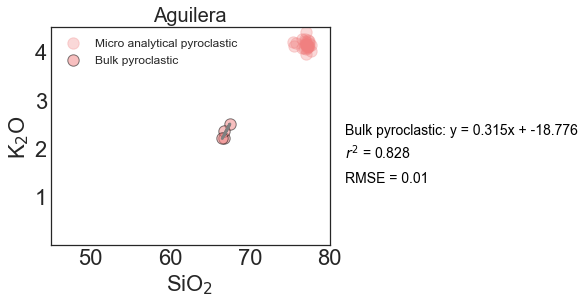

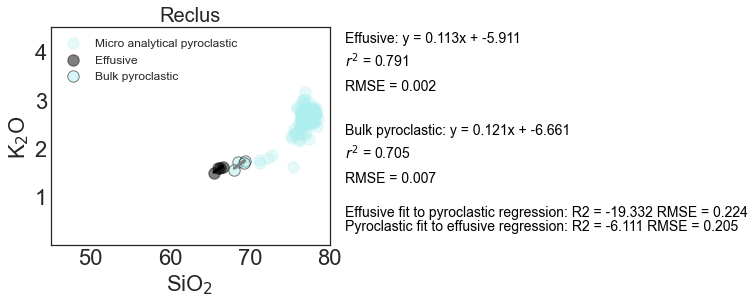

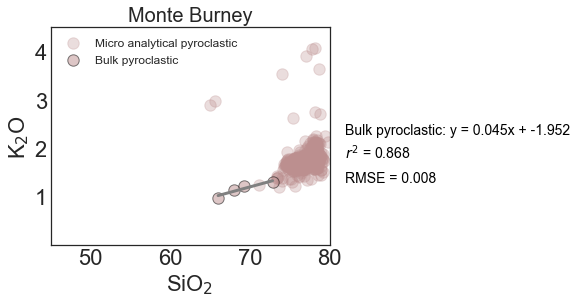

In [39]:
Data = Data.dropna(subset=['SiO2','K2O'],axis=0,how='all')
Data_glass = Data[(Data.TypeOfRegister=='Pyroclastic material')&(Data.TypeOfAnalysis=='Micro Analytical')]
Data_bulk = Data[(Data.TypeOfRegister=='Pyroclastic material')&(Data.TypeOfAnalysis=='Bulk')]
Data_effusive = Data[(Data.TypeOfRegister=='Effusive material')]

volcanoes_by_latitude = ['Llaima','Sollipulli','Caburga-Huelemolle','Villarrica','Quetrupillán','Lanín',
              'Huanquihue Group','Mocho-Choshuenco','Carrán-Los Venados','Puyehue-Cordón Caulle','Antillanca-Casablanca',
              'Osorno','Calbuco','Yate','Apagado','Hornopirén','Huequi','Michinmahuida','Chaitén','Corcovado',
              'Yanteles','Melimoyu','Mentolat','Cay','Macá','Hudson',
              'Lautaro','Viedma','Aguilera','Reclus','Monte Burney']

fit_info = pd.DataFrame()
fit_info['Volcano'] = volcanoes_by_latitude

# R2 and RMSE are measures of the fit of the data to the regression
fit_info['R2_effusive_regression'] = np.nan;fit_info['RMSE_effusive_regression'] = np.nan
fit_info['R2_bulk_pyroclastic_regression'] = np.nan;fit_info['RMSE_bulk_pyroclastic_regression'] = np.nan

# In order to check if 'bulk pyroclastic' data fits the 'effusive' products regression, I calculated R2 and RMSE of
#    the 'bulk pyroclastic' products to the 'effusive' linear regression and viceversa
fit_info['R2_effusive_to_bulk_piroclastic_regression'] = np.nan;fit_info['RMSE_effusive_to_bulk_piroclastic_regression'] = np.nan
fit_info['R2_bulk_pyroclastic_to_effusive_regression'] = np.nan;fit_info['RMSE_bulk_pyroclastic_to_effusive_regression'] = np.nan

for volcan in volcanoes_by_latitude:
    plt.figure(figsize=(5,4))
    ax = plt.axes()
    Color, Marker  = simbologia(volcan,'Unknown')
    index = fit_info.index[fit_info.Volcano == volcan].tolist()[0]
    plt.scatter(Data_glass[Data_glass.Volcano == volcan].SiO2,Data_glass[Data_glass.Volcano == volcan].K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label='Micro analytical pyroclastic')
        
    #----------- 'effusive' products 
    if len(Data_effusive[Data_effusive.Volcano == volcan].SiO2)>2:
        z, rmse, rank, singular_values, rcond = np.polyfit(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,1,full=True)
        p = np.poly1d(z)
        r2 = r2_score(Data_effusive[Data_effusive.Volcano == volcan].K2O, p(Data_effusive[Data_effusive.Volcano == volcan].SiO2))
                
        #---------------- plot 'effusive' data and regression
        plt.scatter(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,color='black',edgecolors ='black',s=130,alpha=0.5,label='Effusive')
        plt.plot(Data_effusive[Data_effusive.Volcano == volcan].SiO2,p(Data_effusive[Data_effusive.Volcano == volcan].SiO2),color='black',linewidth=3)
        #print ("y=%.6fx+(%.6f)"%(z[0],z[1])) 
        ax.text(82,4.2,"Effusive: y = {}x + {}".format(np.around(z[0],3),np.around(z[1],3)),rotation=0,color='black',fontsize=14)
        ax.text(82,3.7,"$r^{2}$ = "+str(np.around(r2,3)),rotation=0,color='black',fontsize=14)
        ax.text(82,3.2,"RMSE = "+str(np.around(rmse[0],3)),rotation=0,color='black',fontsize=14)    
     
        #---------------- save 'effusive' regression's R2 and RMSE
        fit_info.loc[index,'R2_effusive_regression'] = r2
        fit_info.loc[index,'RMSE_effusive_regression'] = rmse
     
    #----------- 'bulk pyroclastic' products    
    if len(Data_bulk[Data_bulk.Volcano == volcan].SiO2)>2:
        z_bulk, rmse_bulk, rank_bulk, singular_values_bulk, rcond_bulk  = np.polyfit(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,1,full=True)
        p_bulk = np.poly1d(z_bulk)
        r2_bulk = r2_score(Data_bulk[Data_bulk.Volcano == volcan].K2O, p_bulk(Data_bulk[Data_bulk.Volcano == volcan].SiO2))

        #---------------- plot 'bulk pyroclastic' data and regression
        plt.scatter(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,color=Color,edgecolors ='black',s=130,alpha=0.5,label='Bulk pyroclastic')
        plt.plot(Data_bulk[Data_bulk.Volcano == volcan].SiO2,p_bulk(Data_bulk[Data_bulk.Volcano == volcan].SiO2),color='grey',linewidth=3)
        #print ("y=%.6fx+(%.6f)"%(z[0],z[1])) 
        ax.text(82,2.3,"Bulk pyroclastic: y = {}x + {}".format(np.around(z_bulk[0],3),np.around(z_bulk[1],3)),rotation=0,color='black',fontsize=14)
        ax.text(82,1.8,"$r^{2}$ = "+str(np.around(r2_bulk,3)),rotation=0,color='black',fontsize=14)
        ax.text(82,1.3,"RMSE = "+str(np.around(rmse_bulk[0],3)),rotation=0,color='black',fontsize=14)

        #---------------- save 'bulk pyroclastic' regression's R2 and RMSE
        fit_info.loc[index,'R2_bulk_pyroclastic_regression'] = r2_bulk
        fit_info.loc[index,'RMSE_bulk_pyroclastic_regression'] = rmse_bulk
        
    if (len(Data_bulk[Data_bulk.Volcano == volcan].SiO2)>2) & (len(Data_effusive[Data_effusive.Volcano == volcan].SiO2)>2):
        #--------------------------- 'bulk pyroclastic' data fit to 'effusive' regression
        r2 = r2_score(Data_bulk[Data_bulk.Volcano == volcan].K2O, p(Data_bulk[Data_bulk.Volcano == volcan].SiO2))
        rmse = np.sqrt(mean_squared_error(Data_bulk[Data_bulk.Volcano == volcan].K2O, p(Data_bulk[Data_bulk.Volcano == volcan].SiO2)))
        ax.text(82,.3,"Pyroclastic fit to effusive regression: R2 = "+str(np.around(r2,3))+" RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14)
        fit_info.loc[index,'R2_effusive_to_bulk_piroclastic_regression'] = r2
        fit_info.loc[index,'RMSE_effusive_to_bulk_piroclastic_regression'] = rmse
        
        #--------------------------- 'effusive' data fit to 'bulk pyroclastic' regression 
        r2 = r2_score(Data_effusive[Data_effusive.Volcano == volcan].K2O, p_bulk(Data_effusive[Data_effusive.Volcano == volcan].SiO2))
        rmse = np.sqrt(mean_squared_error(Data_effusive[Data_effusive.Volcano == volcan].K2O, p_bulk(Data_effusive[Data_effusive.Volcano == volcan].SiO2)))
        ax.text(82,.6,"Effusive fit to pyroclastic regression: R2 = "+str(np.around(r2,3))+" RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14)
        fit_info.loc[index,'R2_bulk_pyroclastic_to_effusive_regression'] = r2
        fit_info.loc[index,'RMSE_bulk_pyroclastic_to_effusive_regression'] = rmse       
            
    
    leg=plt.legend(fancybox=True,ncol=1,loc='upper left',fontsize=12)
    ax.set_xticks([50,60,70,80])
    ax.set_yticks([1,2,3,4])    
    plt.title(volcan, fontsize = 20)
    plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22)
    plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
    ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
    plt.xlim(45,80)
    plt.ylim(0,4.5)
    plt.savefig('../Plots/'+volcan+'_trend.pdf',dpi = 300,bbox_inches='tight')

In [9]:
fit_info

,Volcano,R2_effusive_regression,RMSE_effusive_regression,R2_bulk_pyroclastic_regression,RMSE_bulk_pyroclastic_regression,R2_effusive_to_bulk_piroclastic_regression,RMSE_effusive_to_bulk_piroclastic_regression,R2_bulk_pyroclastic_to_effusive_regression,RMSE_bulk_pyroclastic_to_effusive_regression
0,Llaima,0.528294,0.515120,0.925180,1.072397,0.703003,0.176273,-0.286909,0.149356
1,Sollipulli,NaN,NaN,0.983495,0.116088,NaN,NaN,NaN,NaN
2,Caburga-Huelemolle,0.411723,0.613415,0.012100,0.018006,-2.035939,0.117616,-0.695698,0.265944
3,Villarrica,0.773000,0.058499,0.806907,0.160161,0.190124,0.105811,0.648959,0.067255
4,Quetrupillán,0.936825,0.874285,0.935920,0.421969,0.926443,0.246063,0.850390,0.194023
5,Lanín,0.871612,1.895911,0.788769,0.008535,-0.617249,0.147587,0.589312,0.422342
6,Huanquihue Group,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Mocho-Choshuenco,NaN,NaN,0.857260,2.903823,NaN,NaN,NaN,NaN
8,Carrán-Los Venados,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Puyehue-Cordón Caulle,0.981687,0.730957,0.976670,0.151172,0.970696,0.072626,0.977748,0.127078


### 2.- Filter volcanoes by fit of data to regressions
I considered a good fit of data to the regression when R2 > 0.56 and RMSE < 0.3. Each user might consider different thresholds. 

In [42]:
print('\033[1m'+ 'Case 1: Volcanoes where "effusive" data fit "bulk pyroclastic" regression, and viceversa' + '\033[0m')
Volcanoes_both_fit = fit_info[((fit_info.R2_bulk_pyroclastic_to_effusive_regression > 0.56)
                              & (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression < 0.3))&
                             ((fit_info.R2_effusive_to_bulk_piroclastic_regression > 0.56)
                              & (fit_info.RMSE_effusive_to_bulk_piroclastic_regression < 0.3))].Volcano
print(Volcanoes_both_fit.tolist())
Data_volcanoes_both_fit = Data[Data.Volcano.isin(Volcanoes_both_fit.tolist())]
print(" ")

print('\033[1m'+ 'Case 2: Volcanoes where only "effusive" data fit "bulk pyroclastic" regression' + '\033[0m')
Volcanoes_effusive_fit_pyro = fit_info[((fit_info.R2_bulk_pyroclastic_to_effusive_regression < 0.56)
                              | (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression > 0.3))&
                             ((fit_info.R2_effusive_to_bulk_piroclastic_regression > 0.56)
                              & (fit_info.RMSE_effusive_to_bulk_piroclastic_regression < 0.3))].Volcano
print(Volcanoes_effusive_fit_pyro.tolist())
Data_volcanoes_effusive_fit_pyro = Data[Data.Volcano.isin(Volcanoes_effusive_fit_pyro.tolist())]
print(" ")

print('\033[1m'+ 'Case 3: Volcanoes where only "bulk pyroclastic" data fit "effusive" regression' + '\033[0m')
Volcanoes_pyro_fit_effusive = fit_info[((fit_info.R2_bulk_pyroclastic_to_effusive_regression > 0.56)
                              & (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression < 0.3))&
                             ((fit_info.R2_effusive_to_bulk_piroclastic_regression < 0.56)
                              | (fit_info.RMSE_effusive_to_bulk_piroclastic_regression > 0.3))].Volcano
print(Volcanoes_pyro_fit_effusive.tolist())
Data_volcanoes_pyro_fit_effusive = Data[Data.Volcano.isin(Volcanoes_pyro_fit_effusive.tolist())]
print(" ")

print('\033[1m'+ 'Volcanoes where neither "effusive" data fit "bulk pyroclastic" regression, nor viceversa' + '\033[0m')
Volcanoes_neither_fit = fit_info[((fit_info.R2_bulk_pyroclastic_to_effusive_regression < 0.56)
                              | (fit_info.RMSE_bulk_pyroclastic_to_effusive_regression > 0.3))&
                             ((fit_info.R2_effusive_to_bulk_piroclastic_regression < 0.56)
                              | (fit_info.RMSE_effusive_to_bulk_piroclastic_regression > 0.3))
                              & ((fit_info.R2_bulk_pyroclastic_regression != -1))
                              & (fit_info.R2_effusive_regression != -1)].Volcano
print(Volcanoes_neither_fit.tolist())
print(" ")


print('\033[1m'+ 'Volcanoes with only "effusive" data or "bulk pyroclastic" data' + '\033[0m')
fit_info = fit_info.replace(np.nan,-1)

print('\033[1m'+ 'Case 4: Volcanoes where "effusive" data fit well the regression' + '\033[0m')
Volcanoes_good_effusive_fit = fit_info[((fit_info.R2_effusive_regression > 0.56) & (fit_info.RMSE_effusive_regression < 0.3))
                                   & ((fit_info.R2_bulk_pyroclastic_regression == -1))].Volcano
print(Volcanoes_good_effusive_fit.tolist())
Data_volcanoes_good_effusive_fit = Data[Data.Volcano.isin(Volcanoes_good_effusive_fit.tolist())]
print(" ")

print('\033[1m'+ 'Case 5: Volcanoes where "bulk pyroclastic" data fit well the regression' + '\033[0m')
Volcanoes_good_bulk_pyro_fit = fit_info[(fit_info.R2_effusive_regression == -1)
                                   & ((fit_info.R2_bulk_pyroclastic_regression > 0.56)&(fit_info.RMSE_bulk_pyroclastic_regression < 0.3))].Volcano
print(Volcanoes_good_bulk_pyro_fit.tolist())
Data_volcanoes_good_bulk_pyro_fit = Data[Data.Volcano.isin(Volcanoes_good_bulk_pyro_fit.tolist())]
print(" ")

print('\033[1m'+ 'Volcanoes whith not enough data for the regressions' + '\033[0m')
Volcanoes_no_fit = fit_info[(fit_info.R2_effusive_regression == -1)
                                              & (fit_info.R2_bulk_pyroclastic_regression == -1)].Volcano
print(Volcanoes_no_fit.tolist())
print(" ")


print('\033[1m'+ 'Volcanoes where neither "effusive" nor "bulk pyroclastic" products fit well their respective regressions' + '\033[0m')
Volcanoes_bad_effusive_bulk_pyro_fit = fit_info[((fit_info.R2_effusive_regression == -1)
                                   & ((fit_info.R2_bulk_pyroclastic_regression < 0.56)|(fit_info.RMSE_bulk_pyroclastic_regression > 0.3)))
                                |((fit_info.R2_effusive_regression < 0.56) & (fit_info.RMSE_effusive_regression > 0.3))
                                   & ((fit_info.R2_bulk_pyroclastic_regression == -1)) ].Volcano
print([item for item in Volcanoes_bad_effusive_bulk_pyro_fit.tolist() if item not in (Volcanoes_no_fit.tolist())])
print(" ")


Case 1: Volcanoes where "effusive" data fit "bulk pyroclastic" regression, and viceversa
['Quetrupillán', 'Puyehue-Cordón Caulle', 'Yate', 'Huequi', 'Hudson']
 
Case 2: Volcanoes where only "effusive" data fit "bulk pyroclastic" regression
['Llaima']
 
Case 3: Volcanoes where only "bulk pyroclastic" data fit "effusive" regression
['Villarrica', 'Michinmahuida']
 
Volcanoes where neither "effusive" data fit "bulk pyroclastic" regression, nor viceversa
['Caburga-Huelemolle', 'Lanín', 'Calbuco', 'Melimoyu', 'Reclus']
 
Volcanoes with only "effusive" data or "bulk pyroclastic" data
Case 4: Volcanoes where "effusive" data fit well the regression
['Osorno', 'Corcovado', 'Mentolat', 'Cay', 'Macá']
 
Case 5: Volcanoes where "bulk pyroclastic" data fit well the regression
['Sollipulli', 'Apagado', 'Chaitén', 'Lautaro', 'Aguilera', 'Monte Burney']
 
Volcanoes whith not enough data for the regressions
['Huanquihue Group', 'Carrán-Los Venados', 'Yanteles', 'Viedma']
 
Volcanoes where neither "effu

### 3.- For case 1, 2 and 3: Re calculate regression with both type of products and mesure the distance of each  'micro analytical pyroclastic' sample to that regression.

C:\Users\consue\AppData\Local\Temp\ipykernel_628\1469362308.py:38: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



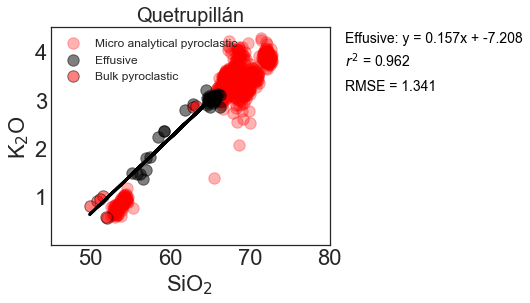

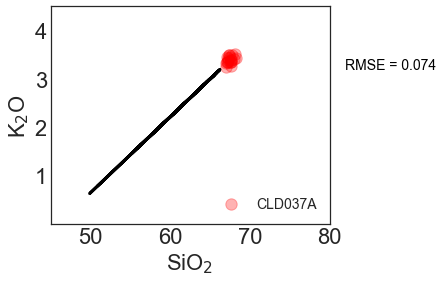

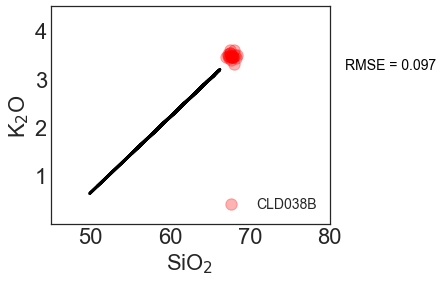

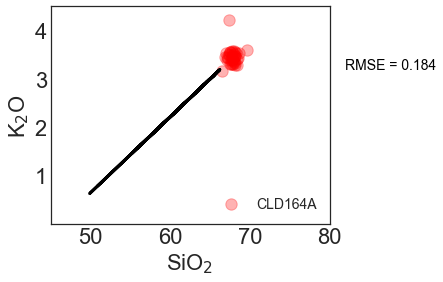

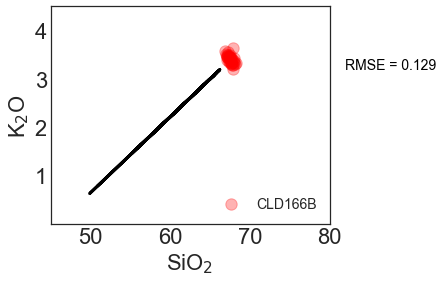

...

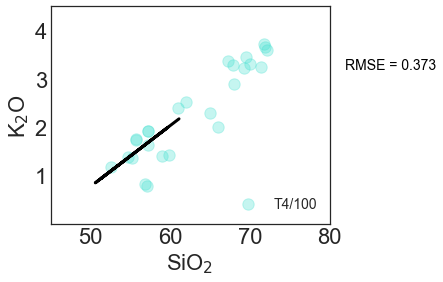

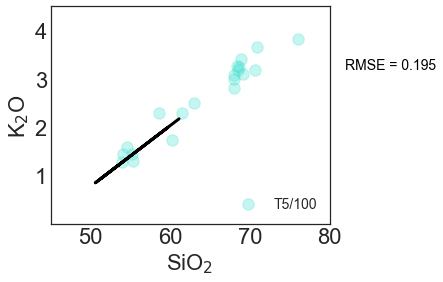

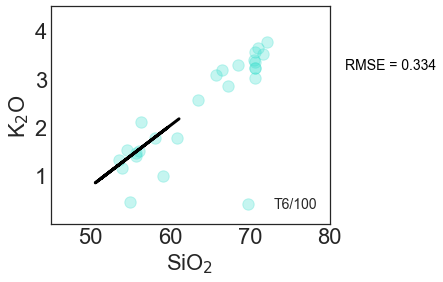

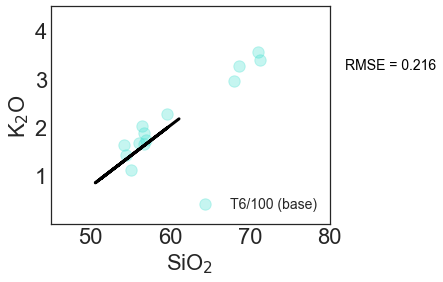

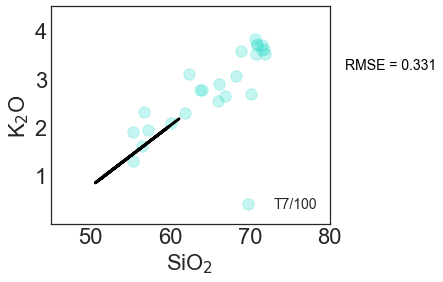

In [49]:
sample_distance_to_fit = pd.DataFrame()
sample_distance_to_fit['Volcano'] = np.nan
sample_distance_to_fit['SampleID'] = Data_glass.SampleID.unique()

#RMSE is what measures the distance of the sample to the regression
sample_distance_to_fit['sample_RMSE_to_regression'] = np.nan

for volcan in Volcanoes_both_fit.tolist()+Volcanoes_effusive_fit_pyro.tolist()+Volcanoes_pyro_fit_effusive.tolist():
    #print(volcan)
    plt.figure(figsize=(5,4));ax = plt.axes()
    Color, Marker  = simbologia(volcan,'Unknown')
    plt.scatter(Data_glass[Data_glass.Volcano == volcan].SiO2,Data_glass[Data_glass.Volcano == volcan].K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label='Micro analytical pyroclastic')
    
    #---------------- plot 'effusive' and 'bulk pyroclastic' data and regression
    Data_regression = Data[((Data.TypeOfRegister=='Pyroclastic material')&(Data.TypeOfAnalysis=='Bulk'))|(Data.TypeOfRegister=='Effusive material')]
    z, rmse, rank, singular_values, rcond = np.polyfit(Data_regression[Data_regression.Volcano == volcan].SiO2,Data_regression[Data_regression.Volcano == volcan].K2O,1,full=True)
    p = np.poly1d(z)
    r2 = r2_score(Data_regression[Data_regression.Volcano == volcan].K2O, p(Data_regression[Data_regression.Volcano == volcan].SiO2))
    plt.scatter(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,color='black',edgecolors ='black',s=130,alpha=0.5,label='Effusive')
    plt.scatter(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,color=Color,edgecolors ='black',s=130,alpha=0.5,label='Bulk pyroclastic')
    plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
        
    ax.text(82,4.2,"Effusive: y = {}x + {}".format(np.around(z[0],3),np.around(z[1],3)),rotation=0,color='black',fontsize=14)
    ax.text(82,3.7,"$r^{2}$ = "+str(np.around(r2,3)),rotation=0,color='black',fontsize=14)
    ax.text(82,3.2,"RMSE = "+str(np.around(rmse[0],3)),rotation=0,color='black',fontsize=14)    

    leg=plt.legend(fancybox=True,ncol=1,loc='upper left',fontsize=12)
    ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
    plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
    ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
    plt.xlim(45,80);plt.ylim(0,4.5)
    plt.title(volcan, fontsize = 20)
    
    temp = Data_glass[(Data_glass.Volcano==volcan)]
        
    for sample in temp.SampleID.unique():
        #print(sample)
        plt.figure(figsize=(5,4));ax = plt.axes()
        temp2 = temp[temp.SampleID==sample]
        plt.scatter(temp2.SiO2,temp2.K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label=sample)
        plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
   
        # calculate distance (RMSE) of 'Sample' to the regression
        rmse = np.sqrt(mean_squared_error(temp2.K2O, p(temp2.SiO2)))
        ax.text(82,3.2,"RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14)    
        index =  sample_distance_to_fit.index[sample_distance_to_fit.SampleID == sample].tolist()[0]   
        
        # save distance (RMSE) of 'Sample'
        sample_distance_to_fit.loc[index,'sample_RMSE_to_regression'] = rmse  
        sample_distance_to_fit.loc[index,'Volcano'] = volcan
        
        leg=plt.legend(fancybox=True,ncol=1,loc='lower right',fontsize=14)
        ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
        plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
        ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
        plt.xlim(45,80);plt.ylim(0,4.5)
           

### 4.- For case 4 and 5 Mesure the distance of each 'micro analytical pyroclastic' sample to the respective 'effusive' or 'bulk pyroclastic' regression.

C:\Users\consue\AppData\Local\Temp\ipykernel_628\67805111.py:31: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



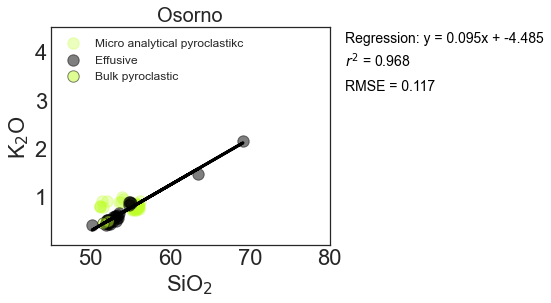

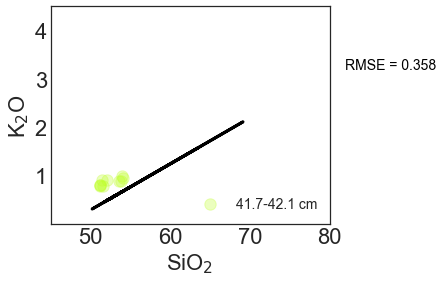

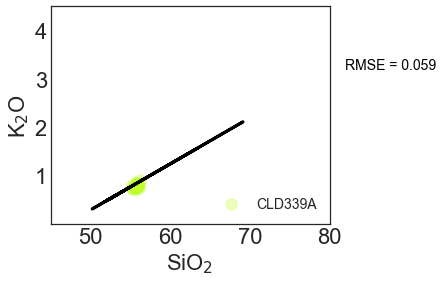

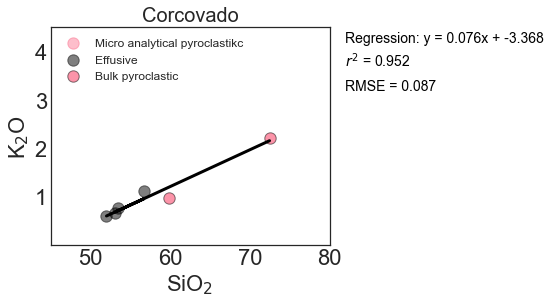

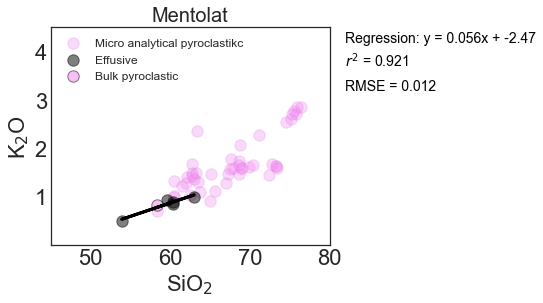

...

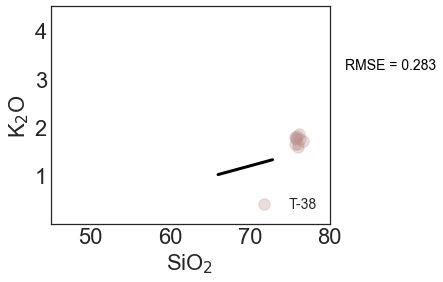

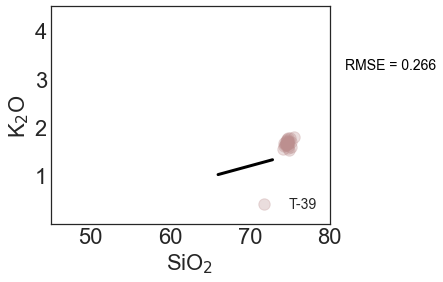

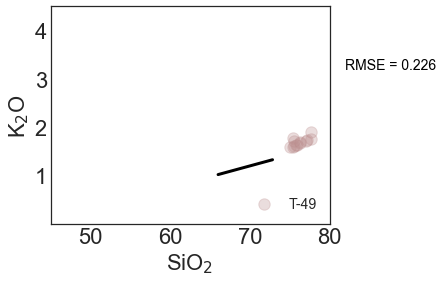

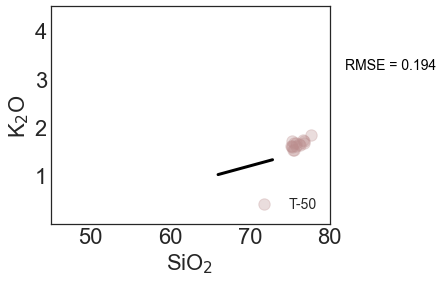

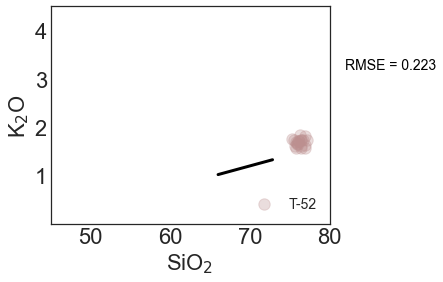

In [51]:
for volcan in Volcanoes_good_effusive_fit.tolist()+Volcanoes_good_bulk_pyro_fit.tolist():
    #print(volcan)
    plt.figure(figsize=(5,4));ax = plt.axes()
    Color, Marker  = simbologia(volcan,'Unknown')
    plt.scatter(Data_glass[Data_glass.Volcano == volcan].SiO2,Data_glass[Data_glass.Volcano == volcan].K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label='Micro analytical pyroclastikc')
    
    #---------------- plot all 'effusive' or 'bulk pyroclastic' data and regression
    Data_regression = Data[((Data.TypeOfRegister=='Pyroclastic material')&(Data.TypeOfAnalysis=='Bulk'))|(Data.TypeOfRegister=='Effusive material')]
    z, rmse, rank, singular_values, rcond = np.polyfit(Data_regression[Data_regression.Volcano == volcan].SiO2,Data_regression[Data_regression.Volcano == volcan].K2O,1,full=True)
    p = np.poly1d(z)
    r2 = r2_score(Data_regression[Data_regression.Volcano == volcan].K2O, p(Data_regression[Data_regression.Volcano == volcan].SiO2))
    plt.scatter(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,color='black',edgecolors ='black',s=130,alpha=0.5,label='Effusive')
    plt.scatter(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,color=Color,edgecolors ='black',s=130,alpha=0.5,label='Bulk pyroclastic')
    plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
        
    ax.text(82,4.2,"Regression: y = {}x + {}".format(np.around(z[0],3),np.around(z[1],3)),rotation=0,color='black',fontsize=14)
    ax.text(82,3.7,"$r^{2}$ = "+str(np.around(r2,3)),rotation=0,color='black',fontsize=14)
    ax.text(82,3.2,"RMSE = "+str(np.around(rmse[0],3)),rotation=0,color='black',fontsize=14)    

    leg=plt.legend(fancybox=True,ncol=1,loc='upper left',fontsize=12)
    ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
    plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
    ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
    plt.xlim(45,80);plt.ylim(0,4.5)
    plt.title(volcan, fontsize = 20)
    
    temp = Data_glass[(Data_glass.Volcano==volcan)]
        
    for sample in temp.SampleID.unique():
        #print(sample)
        plt.figure(figsize=(5,4));ax = plt.axes()
        temp2 = temp[temp.SampleID==sample]
        
        #plot 'Sample'
        plt.scatter(temp2.SiO2,temp2.K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label=sample)
        plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
   
        # calculate distance (RMSE) of 'Sample' to the regression
        rmse = np.sqrt(mean_squared_error(temp2.K2O, p(temp2.SiO2)))
        ax.text(82,3.2,"RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14)    
        index =  sample_distance_to_fit.index[sample_distance_to_fit.SampleID == sample].tolist()[0]  
        
        # save distance (RMSE) of 'Sample'
        sample_distance_to_fit.loc[index,'sample_RMSE_to_regression'] = rmse  
        sample_distance_to_fit.loc[index,'Volcano'] = volcan
        
        leg=plt.legend(fancybox=True,ncol=1,loc='lower right',fontsize=14)
        ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
        plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
        ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
        plt.xlim(45,80);plt.ylim(0,4.5)
        

In [60]:
sample_distance_to_fit = sample_distance_to_fit.dropna(subset=['Volcano'])
fig = px.scatter(sample_distance_to_fit, sample_distance_to_fit.Volcano, sample_distance_to_fit.sample_RMSE_to_regression,
                 color = 'Volcano', hover_data = ['SampleID','sample_RMSE_to_regression'],width=800, height=500)
fig.show()

### 5.- For the 'Samples' with a distance higher-than-accepted from the respective regression, measure the distance to the regression of each 'SampleObservation'
In this case the threshold I used is with sample_RMSE_to_regression > 0.3. Each user might consider different thresholds. 

C:\Users\consue\AppData\Local\Temp\ipykernel_628\2311038651.py:63: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



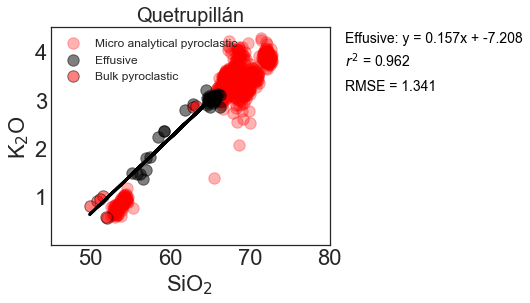

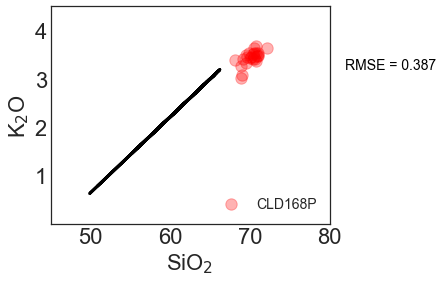

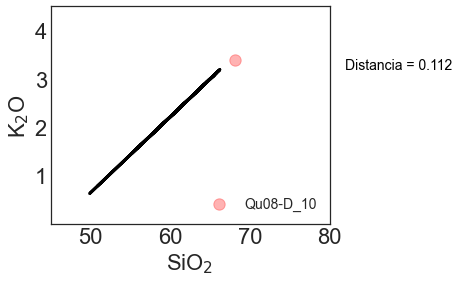

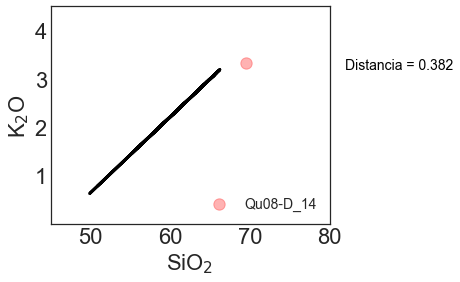

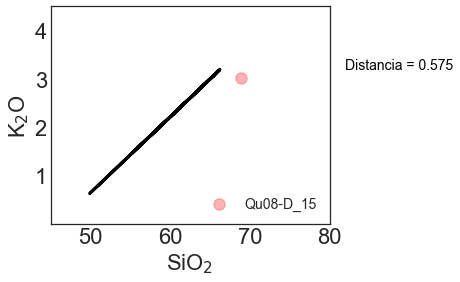

...

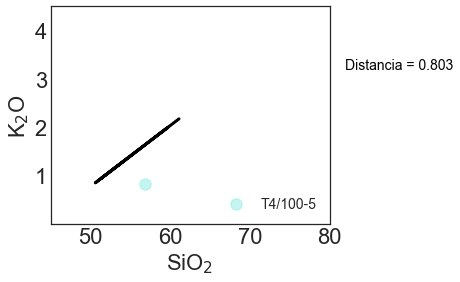

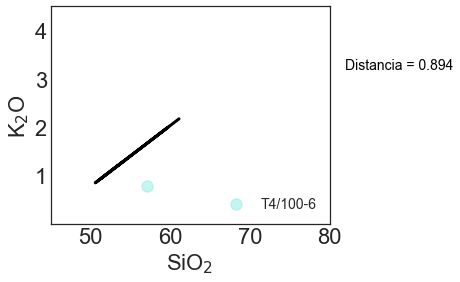

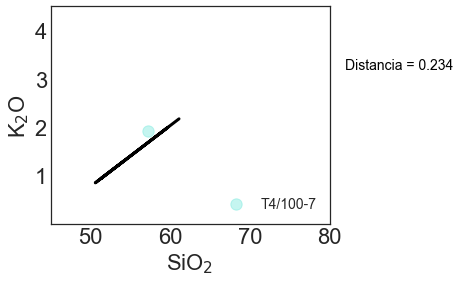

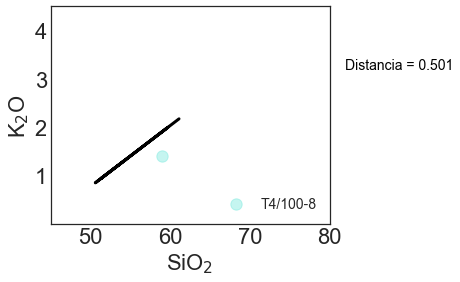

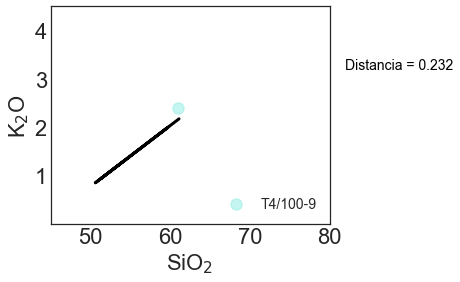

In [52]:
sampleObs_distance_to_fit = pd.DataFrame()
sampleObs_distance_to_fit['Volcano'] = np.nan
sampleObs_distance_to_fit['SampleObservationID'] = Data_glass.SampleObservationID.unique() 
sampleObs_distance_to_fit['SampleObservation_distance_to_regression'] = np.nan

for volcan in Volcanoes_both_fit.tolist()+Volcanoes_effusive_fit_pyro.tolist()+Volcanoes_pyro_fit_effusive.tolist():
    #print(volcan)
    plt.figure(figsize=(5,4));ax = plt.axes()
    Color, Marker  = simbologia(volcan,'Unknown')
    plt.scatter(Data_glass[Data_glass.Volcano == volcan].SiO2,Data_glass[Data_glass.Volcano == volcan].K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label='Micro analytical pyroclastic')
    
    #---------------- plot all 'effusive' or 'bulk pyroclastic' data and regression
    z, rmse, rank, singular_values, rcond = np.polyfit(Data_regression[Data_regression.Volcano == volcan].SiO2,Data_regression[Data_regression.Volcano == volcan].K2O,1,full=True)
    p = np.poly1d(z)
    r2 = r2_score(Data_regression[Data_regression.Volcano == volcan].K2O, p(Data_regression[Data_regression.Volcano == volcan].SiO2))
    plt.scatter(Data_effusive[Data_effusive.Volcano == volcan].SiO2,Data_effusive[Data_effusive.Volcano == volcan].K2O,color='black',edgecolors ='black',s=130,alpha=0.5,label='Effusive')
    plt.scatter(Data_bulk[Data_bulk.Volcano == volcan].SiO2,Data_bulk[Data_bulk.Volcano == volcan].K2O,color=Color,edgecolors ='black',s=130,alpha=0.5,label='Bulk pyroclastic')
    plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
        
    ax.text(82,4.2,"Effusive: y = {}x + {}".format(np.around(z[0],3),np.around(z[1],3)),rotation=0,color='black',fontsize=14)
    ax.text(82,3.7,"$r^{2}$ = "+str(np.around(r2,3)),rotation=0,color='black',fontsize=14)
    ax.text(82,3.2,"RMSE = "+str(np.around(rmse[0],3)),rotation=0,color='black',fontsize=14)    

    leg=plt.legend(fancybox=True,ncol=1,loc='upper left',fontsize=12)
    ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
    plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
    ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
    plt.xlim(45,80);plt.ylim(0,4.5)
    plt.title(volcan, fontsize = 20)
    temp = Data_glass[(Data_glass.Volcano==volcan)]
        
    for sample in temp.SampleID.unique():
         #filter samples with RMSE higher than 0.35 (arbitrary threshold, could change in the future, mainly to higher values)
        if sample_distance_to_fit[sample_distance_to_fit.SampleID == sample].sample_RMSE_to_regression.values[0]>0.35:
            
            #Plot the 'Sample'
            plt.figure(figsize=(5,4));ax = plt.axes()
            temp2 = temp[temp.SampleID==sample]
            plt.scatter(temp2.SiO2,temp2.K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label=sample)
            plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
            rmse = np.sqrt(mean_squared_error(temp2.K2O, p(temp2.SiO2)))
            ax.text(82,3.2,"RMSE = "+str(np.around(rmse,3)),rotation=0,color='black',fontsize=14) 
        
            leg=plt.legend(fancybox=True,ncol=1,loc='lower right',fontsize=14)
            ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
            plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
            ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
            plt.xlim(45,80);plt.ylim(0,4.5)
            
            for sampleObs in temp2.SampleObservationID.unique().tolist():
                #print(sampleObs)
                temp3 = temp2[temp2.SampleObservationID==sampleObs]
                a = -z[0]; c = -z[1]; b = 1
                shortestDistance = np.linalg.norm(a*temp3.SiO2+b*temp3.K2O+c)/np.sqrt(a*a+b*b)
                index =  sampleObs_distance_to_fit.index[sampleObs_distance_to_fit.SampleObservationID == sampleObs].tolist()[0]
                
                # save distance of 'SampleObservation' to the regression
                #    if curve is ax + bx + c = 0, then distance of a point to the curve is |aX0 + bx0 + c| / sqrt(a^2 + b^2)) 
                sampleObs_distance_to_fit.loc[index,'SampleObservation_distance_to_regression'] = shortestDistance
                sampleObs_distance_to_fit.loc[index,'Volcano'] = volcan
                
                #Plot the 'SampleObservation'
                plt.figure(figsize=(5,4));ax = plt.axes()
                plt.scatter(temp3.SiO2,temp3.K2O,color=Color,edgecolors =Color,s=130,alpha=0.3,label=sampleObs)
                plt.plot(Data_regression[Data_regression.Volcano == volcan].SiO2,p(Data_regression[Data_regression.Volcano == volcan].SiO2),color='black',linewidth=3)
                ax.text(82,3.2,"Distancia = "+str(np.around(shortestDistance,3)),rotation=0,color='black',fontsize=14) 
                
                leg=plt.legend(fancybox=True,ncol=1,loc='lower right',fontsize=14)
                ax.set_xticks([50,60,70,80]);ax.set_yticks([1,2,3,4])    
                plt.xlabel(r"SiO$_{\rm 2}$", fontsize = 22);plt.ylabel(r"K$_{\rm 2}$O", fontsize = 22)
                ax.tick_params(labelsize = 22,direction='in',axis='both')#,visible = True
                plt.xlim(45,80);plt.ylim(0,4.5)

In [59]:
sampleObs_distance_to_fit = sampleObs_distance_to_fit.dropna(subset=['Volcano'])
fig = px.scatter(sampleObs_distance_to_fit, sampleObs_distance_to_fit.Volcano, sampleObs_distance_to_fit.SampleObservation_distance_to_regression,
                 color = 'Volcano', hover_data = ['SampleObservationID','SampleObservation_distance_to_regression'],width=800, height=500)
fig.show()